In [1]:
%reset
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import cross_val_score
from sklearn.tree import export_graphviz

train1 = pd.read_csv("C:\\Users\\Deepa kumari\\Downloads\\train_dataset01.csv")


Once deleted, variables cannot be recovered. Proceed (y/[n])? y


In [2]:
train2 = pd.read_csv("C:\\Users\\Deepa kumari\\Downloads\\train_dataset02.csv")
test = pd.read_csv("C:\\Users\\Deepa kumari\\Downloads\\test_dataset.csv")

In [3]:
def create_new_features(data, fluc_window, MA_window):
    """
    Fluctions refer to the sum of differences
    between each row and its previous row in a window
    """
    numerics = data.select_dtypes(include="float64")
    booleans = data.select_dtypes(include="bool")
    
    # Calculate fluctuations
    flucs = numerics.diff()
    flucs = flucs.abs()
    flucs = flucs.rolling(fluc_window).sum()
    flucs = flucs.fillna(0)
    flucs.columns = [str(col) + '_delta_t' for col in flucs.columns]
    
    # Calculate Moving Average
    ma = numerics.rolling(MA_window).mean()
    ma = ma.fillna(numerics.mean())
    ma.columns = [str(col) + '_MA' for col in ma.columns]
    
    # Create output
    out = pd.concat([data.reset_index(drop=True), flucs], axis=1)
    out = pd.concat([out.reset_index(drop=True), ma], axis=1)

    return out

In [4]:
# Function to standardize features
def standardise(data, means, stds):
    """
    Standardise every numeric column based on given
    means and stds
    """
    numeric_cols = data.select_dtypes(include="float64").columns
    data[numeric_cols] = (data[numeric_cols] - means)/stds

In [5]:
# Function to build one tree for each feature
def create_trees(data):
    """
    For each feature, build a tree to detect anomalies
    """
    trees = {}
    for col in data.columns:
        if str(col) not in ["ATT_FLAG", "DATETIME"]:
            clf = DecisionTreeClassifier(max_depth=1)
            clf = clf.fit(data[[col]], data["ATT_FLAG"])
            trees[col] = clf

    return trees

In [6]:
# Function to vote anomalies from tree results
def create_votes(data, trees):
    """
    For each column, use decision tree to decide whether 
    it is an anomaly. Votes are then summed up into a votes column
    """
    # Predict
    votes = pd.DataFrame()
    for col in data.columns:
        if str(col) in trees:
            try:
                votes[col] = trees[col].predict(data[[col]])
            except Exception:
                continue
            
    # Sum
    data["votes"] = votes.sum(axis=1)

In [7]:
# Function to get scores from votes
def create_scores(data, alpha):
    """
    Create score from votes
    Each score depends on all previous scores
    """
    scores = []
    for i in range(len(data["votes"])):
        if i > 1:
            score = alpha*scores[i-1] + data["votes"][i]
        else:
            score = data["votes"][i]
        scores.append(score)
    return scores

In [8]:
# Function to change scores to ATT_FLAG
def create_ATT_FLAG(data, scores, min_votes):
    """
    Create dataframe in submission format
    """
    temp = np.asarray(scores)

    out = data[["DATETIME"]].copy()
    out["ATT_FLAG"] = np.where(temp >= min_votes, 1, 0)

    return out

In [9]:
def frange(x, y, jump):
    """
    range for floats
    """
    while x < y:
        yield x
        x += jump

In [10]:
# Drop continuous columns that do not want to use in trees
ignore = ["LEVEL_T5", "FLOW_PU3", "FLOW_PU5", "FLOW_PU9"]
train2 = train2.drop(ignore, axis=1)

# Create new features
train2 = create_new_features(train2, 10, 10)
test = create_new_features(test, 10, 10)

# Learn mean and std from no attack data
no_attacks = train2[~train2.ATT_FLAG]
means = no_attacks.select_dtypes(include="float64").mean()
stds = no_attacks.select_dtypes(include="float64").std()

# Standardize
standardise(train2, means, stds)
standardise(test, means, stds)

# Build trees
trees = create_trees(train2)

# Create votes
create_votes(train2, trees)
create_votes(test, trees)

In [11]:
# Grid Search for best decay rate and min_vote
bestF1 = 0
bestAlpha = 0
bestMinVotes = 0
y_true = train2.ATT_FLAG

for alpha in frange(0.5, 0.99, 0.01):
    train2_scores = create_scores(train2, alpha)

    for min_votes in range(1, 100):            
        train2_out = create_ATT_FLAG(train2, train2_scores, min_votes)

        # Calculate F score in train2
        y_pred = train2_out.ATT_FLAG == 1
        f1 = f1_score(y_true, y_pred)

        if f1 > bestF1:
            bestF1 = f1
            bestAlpha = alpha
            bestMinVotes = min_votes
                
print(bestF1, bestAlpha, bestMinVotes)

0.8194736842105264 0.5 4


In [12]:
test_scores = create_scores(test, 0.9)

In [13]:
test_out = create_ATT_FLAG(test, test_scores, 4)

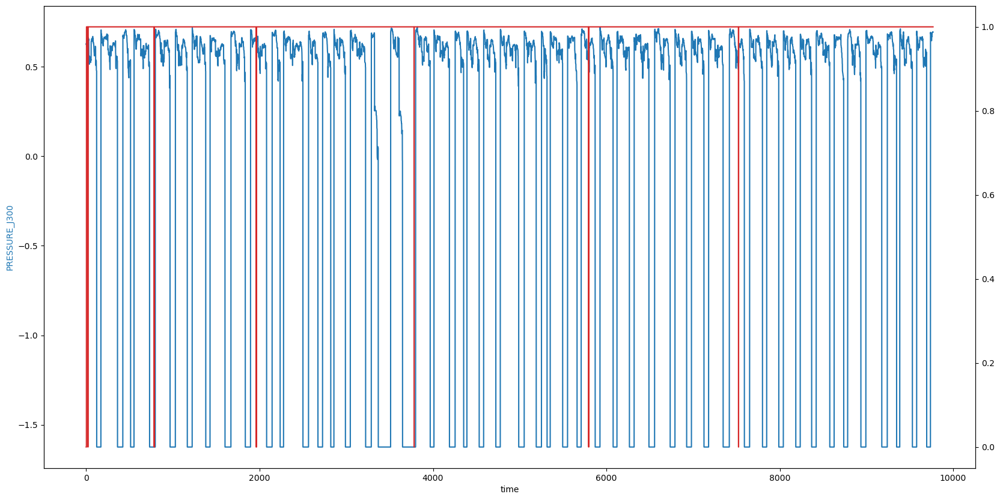

In [14]:
# Plot
fig, ax1 = plt.subplots(figsize=(20, 10))

color = 'tab:blue'
ax1.set_xlabel('time')
ax1.set_ylabel('PRESSURE_J300', color=color)
ax1.plot(test['PRESSURE_J300'], color=color)

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
color = 'tab:red'
ax2.plot(test_out['ATT_FLAG'], color=color)

plt.show()

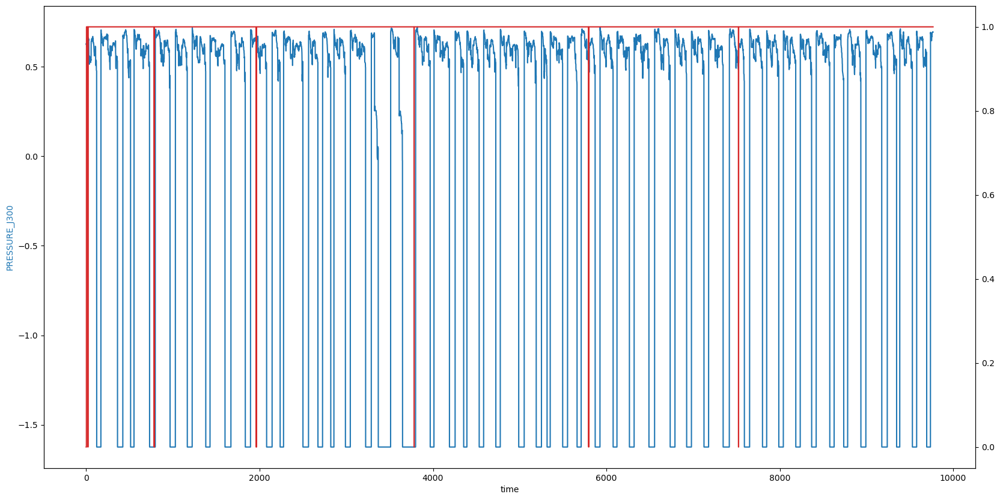

In [15]:
# Plot
fig, ax1 = plt.subplots(figsize=(20, 10))

color = 'tab:blue'
ax1.set_xlabel('time')
ax1.set_ylabel('PRESSURE_J300', color=color)
ax1.plot(test['PRESSURE_J300'], color=color)

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

color = 'tab:red'
ax2.plot(test_out['ATT_FLAG'], color=color)

plt.show()

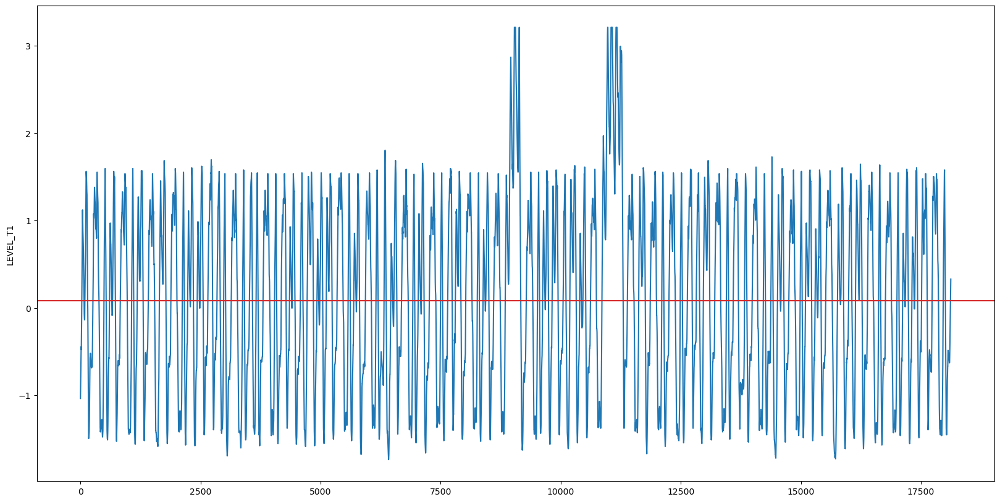

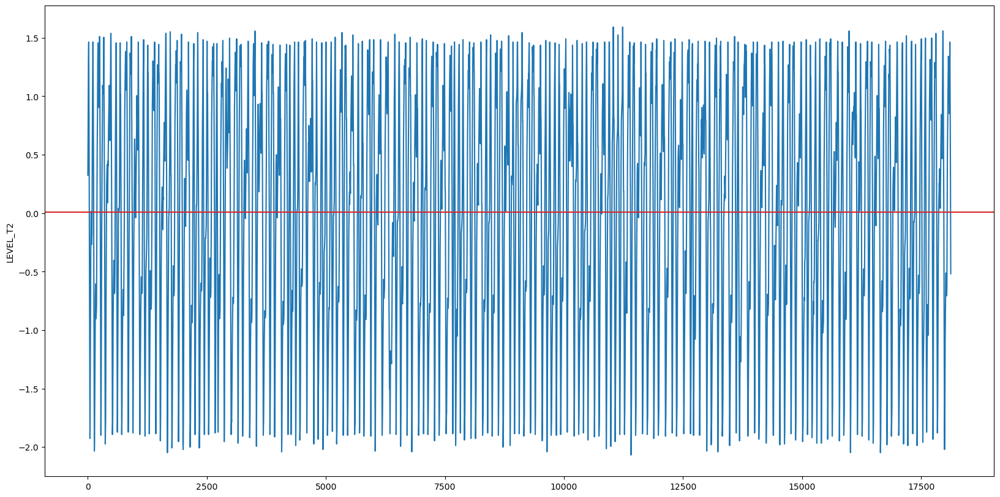

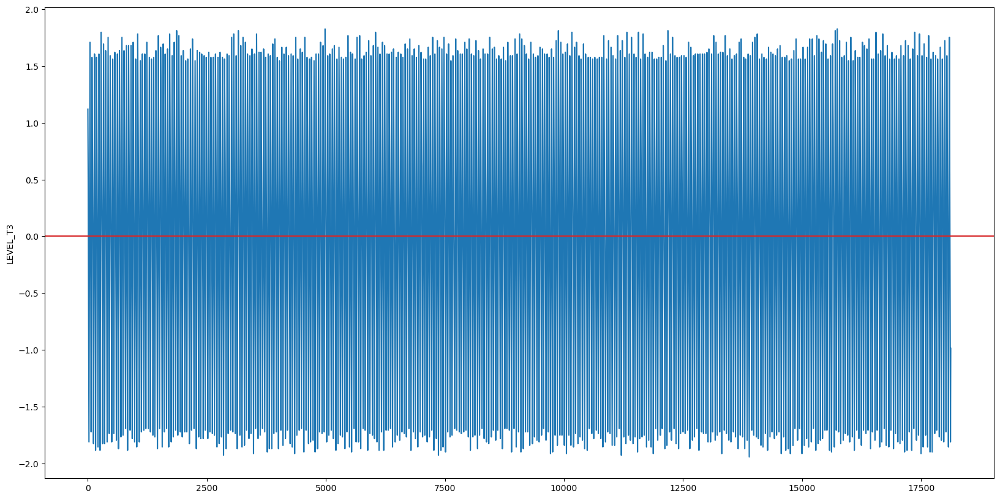

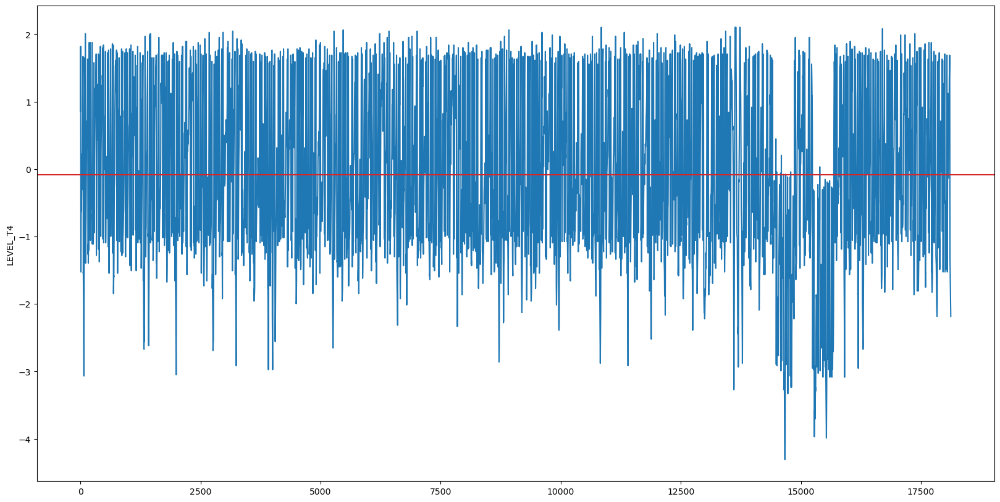

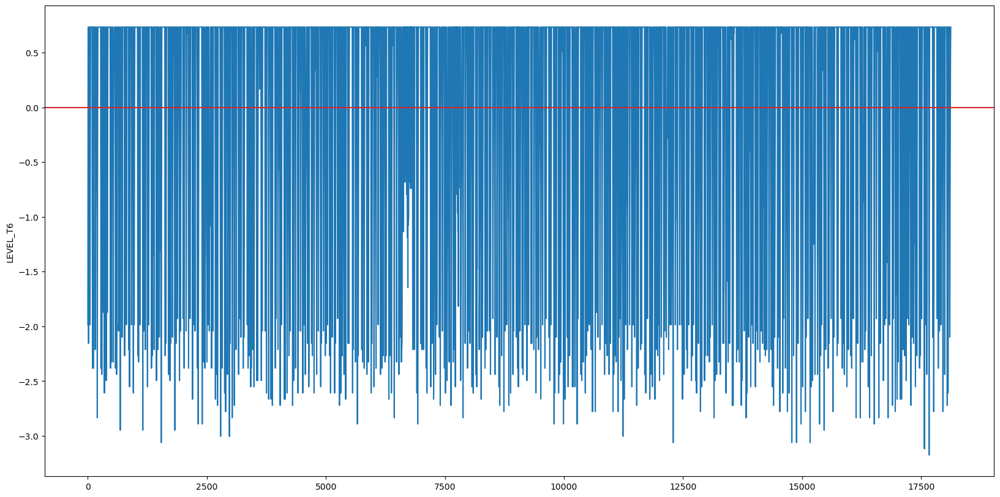

...

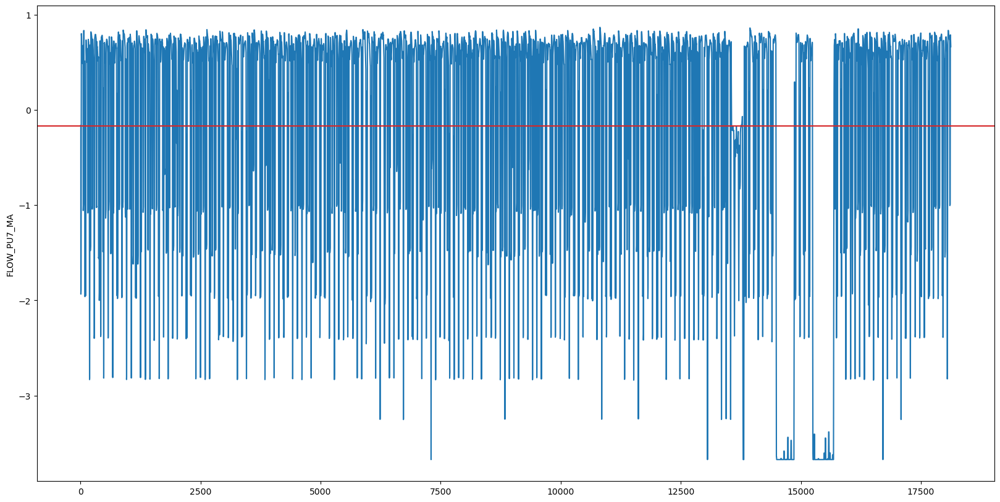

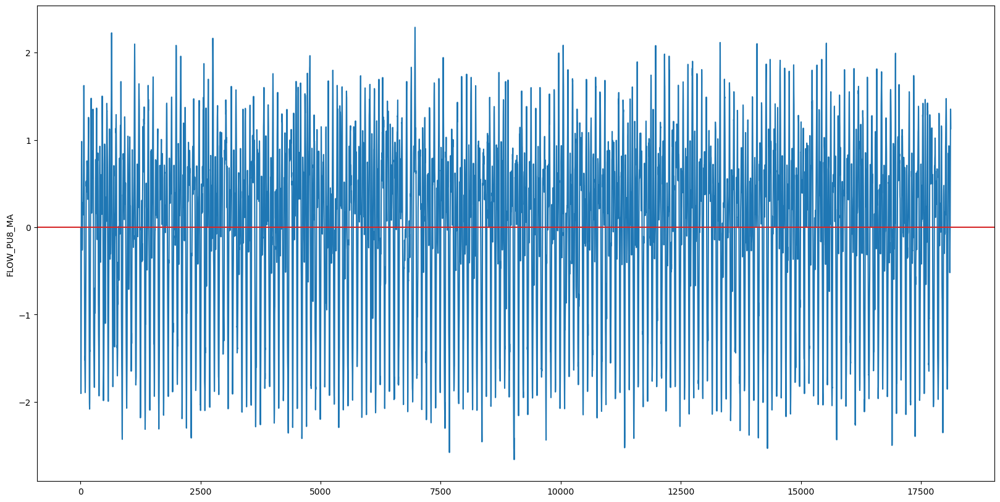

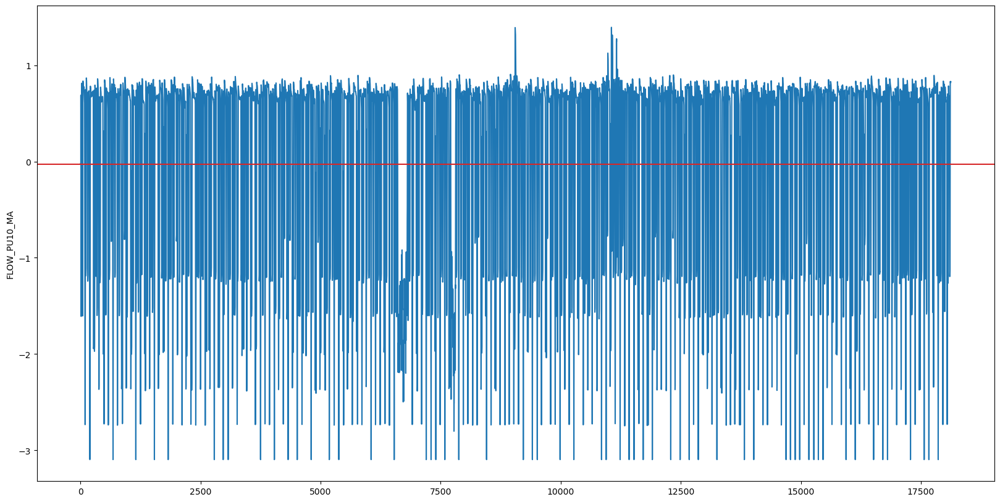

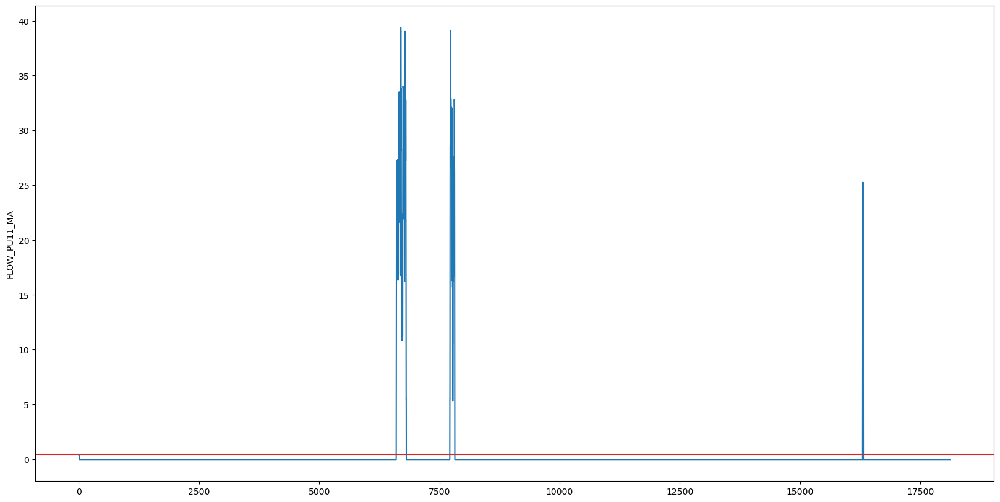

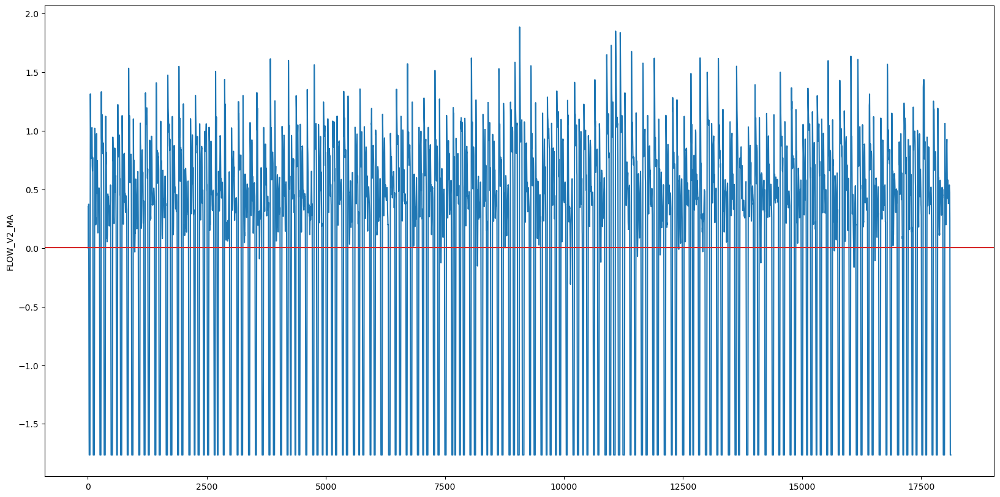

In [16]:
numerics = train2.select_dtypes(include="float64")
means = numerics.mean()

for col in numerics.columns:
    fig, ax = plt.subplots(figsize=(20, 10))
    ax.plot(numerics[col])
    ax.set_ylabel(col)
    
    color = 'tab:red'
    plt.axhline(y=means[col], color=color)
    plt.show()

In [18]:
import pandas as pd
import numpy as np
import scipy.stats as stats
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score
from scipy.signal import butter, lfilter, freqz
train1 = pd.read_csv("C:\\Users\\Deepa kumari\\Downloads\\train_dataset01.csv")

train2 = pd.read_csv("C:\\Users\\Deepa kumari\\Downloads\\train_dataset02.csv")
test = pd.read_csv("C:\\Users\\Deepa kumari\\Downloads\\test_dataset.csv")

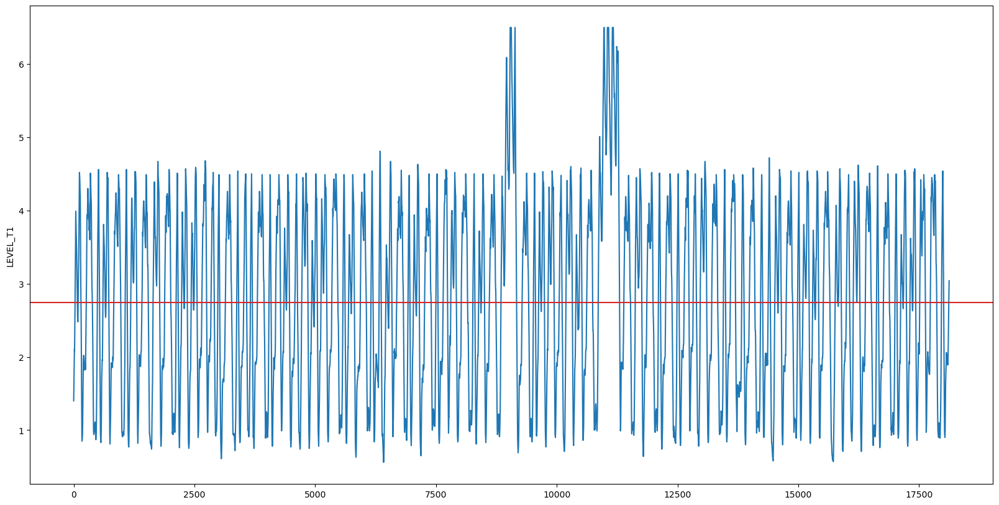

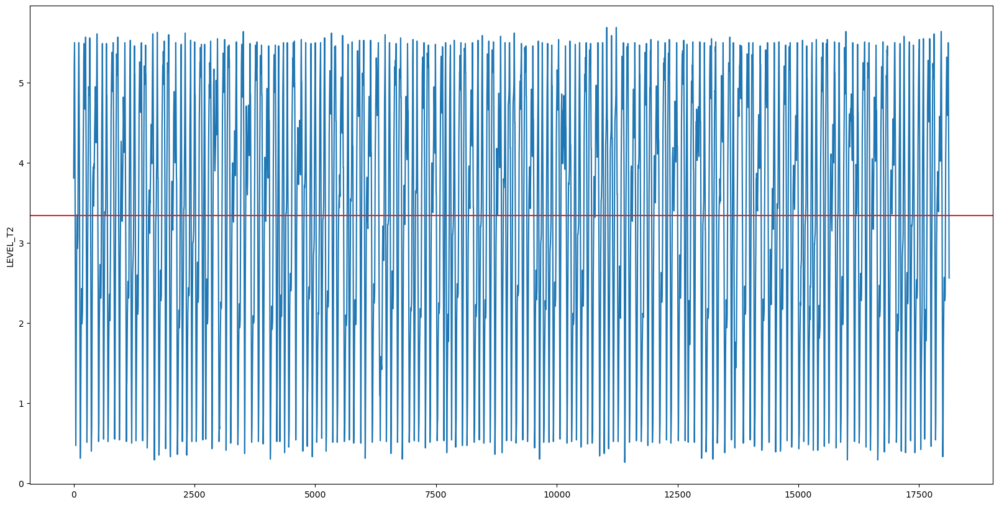

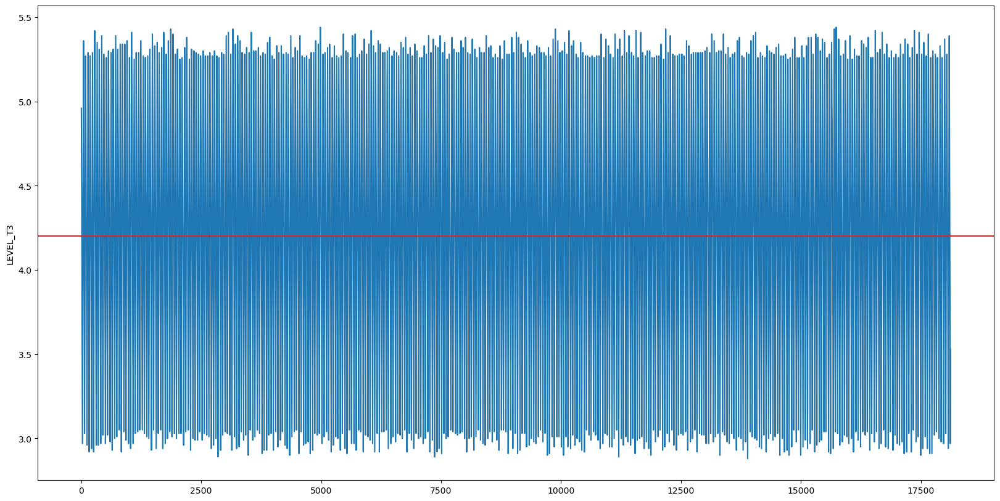

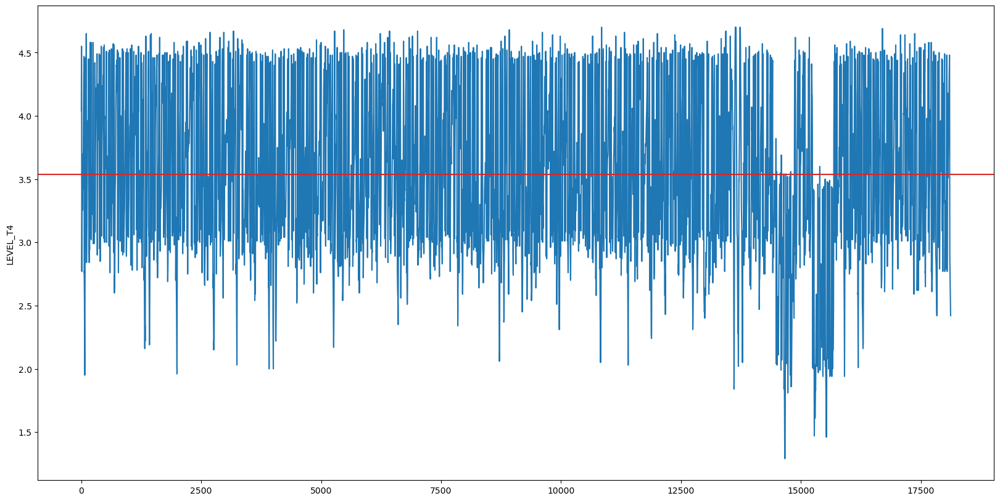

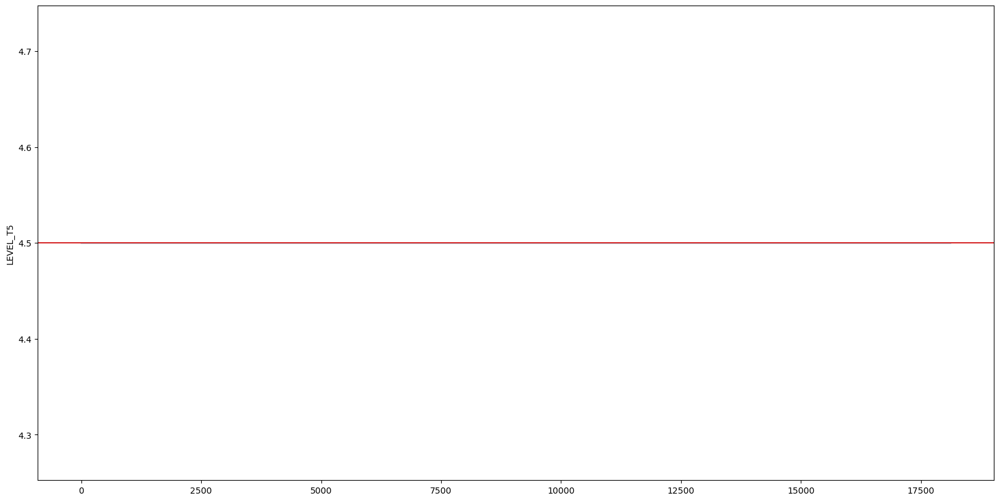

...

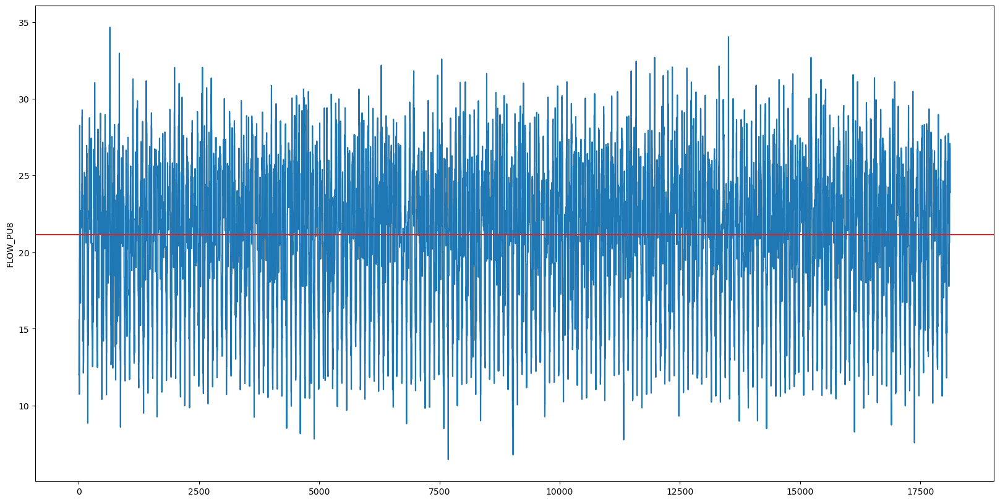

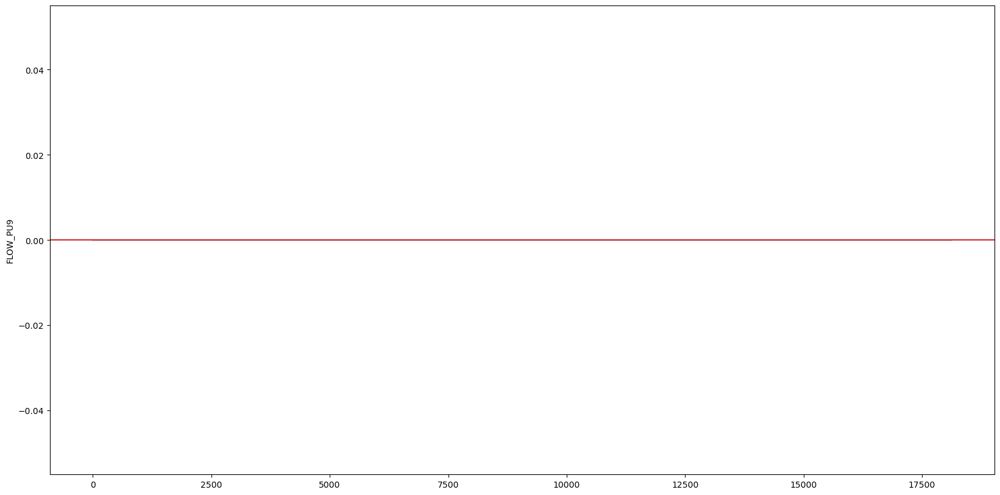

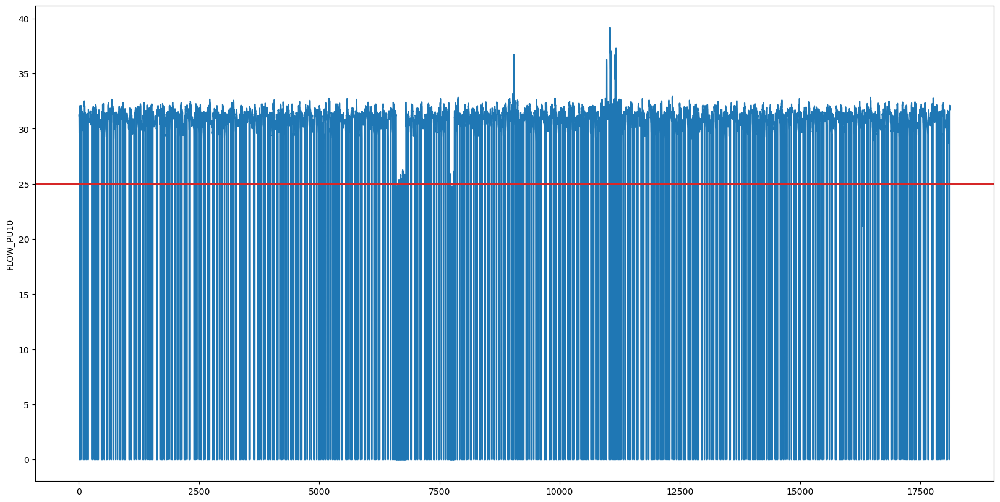

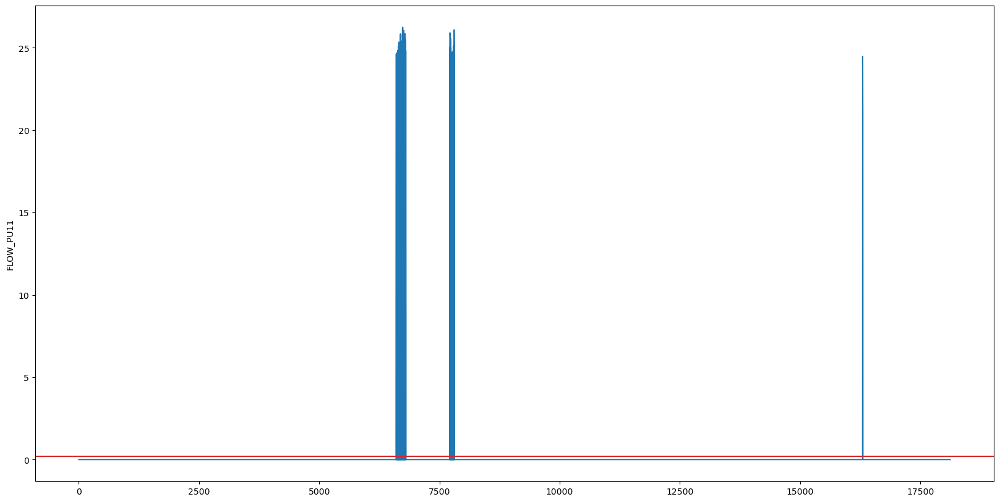

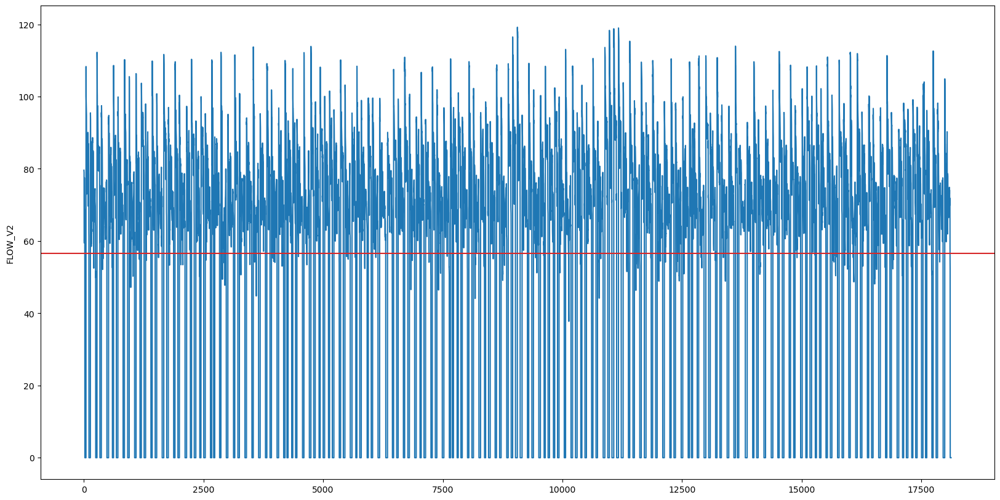

In [19]:
numerics = train2.select_dtypes(include="float64")
means = numerics.mean()

for col in numerics.columns:
    fig, ax = plt.subplots(figsize=(20, 10))
    ax.plot(numerics[col])
    ax.set_ylabel(col)
    
    color = 'tab:red'
    plt.axhline(y=means[col], color=color)
    plt.show()

In [22]:
%matplotlib inline
import numpy as np
import math
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import f1_score
dat = pd.read_csv("C:\\Users\\Deepa kumari\\Downloads\\test_dataset.csv")

LEVELT1


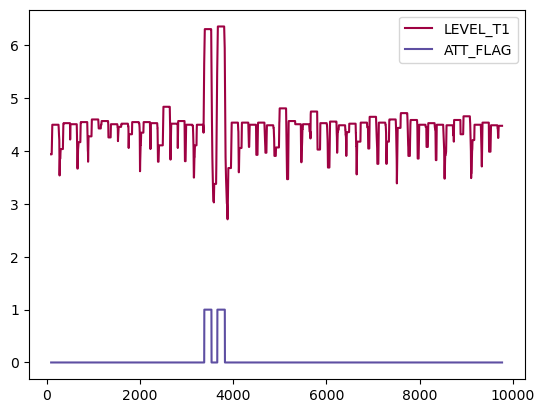

LEVELT2


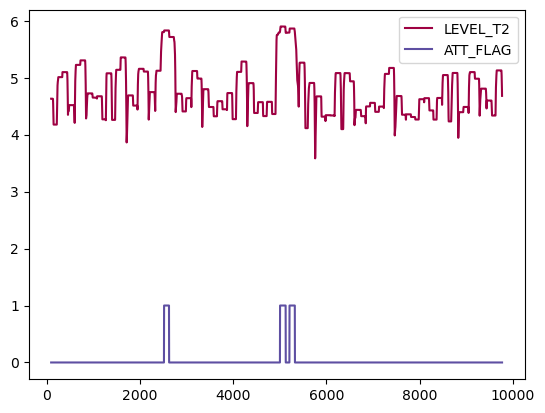

LEVELT3


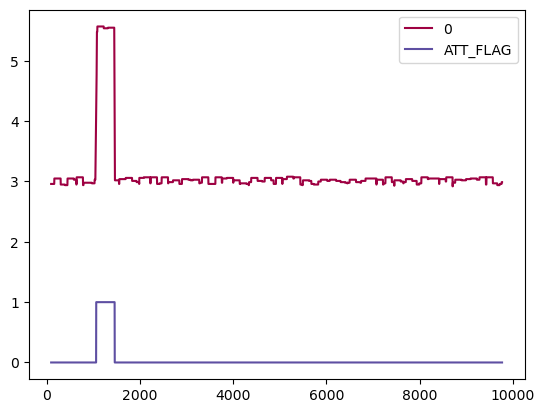

LEVELT7


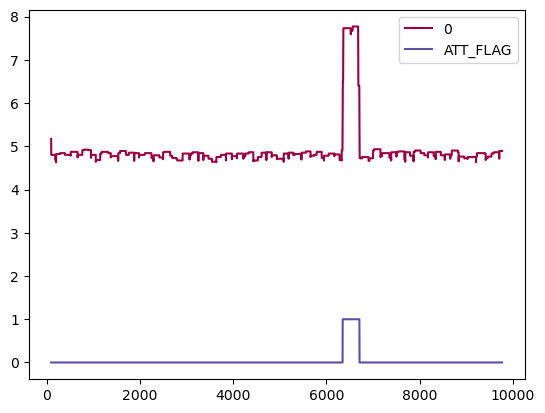

In [25]:
import pandas as pd
import matplotlib.pyplot as plt

OVERKILLGLOBALJOY = []
allsets = []
contextual_window = 38

# Initialize OVERKILLGLOBALJOY with the size of the dataset
for i in range(len(dat["LEVEL_T1"])):
    OVERKILLGLOBALJOY.append(False)

def overkill(somerolling_max, threshold=0.9):
    smallest = somerolling_max.min()
    largest = somerolling_max.max()
    completeRange = largest - smallest
    threshold = 2.0 * somerolling_max.std() + somerolling_max.mean()

    limit = threshold  # or you can use `limit = threshold + smallest` if required
    ans = []

    for i in range(len(somerolling_max)):
        if somerolling_max.iloc[i] > limit:
            ans.append(True)
            OVERKILLGLOBALJOY[i] = True
        else:
            ans.append(False)

    # Convert somerolling_max to DataFrame
    somerolling_max = pd.DataFrame(somerolling_max)
    holdingSeries = pd.Series(data=ans)
    somerolling_max = somerolling_max.assign(ATT_FLAG=holdingSeries)

    # Plotting the result
    somerolling_max.rolling(100).max().plot.line(colormap="Spectral")
    plt.show()

    allsets.append(ans)
    return somerolling_max  # return the DataFrame with the new series


def invertir(somerolledthing):
    mean = somerolledthing.mean()
    resultant = [((val - mean) * (-1)) + mean for val in somerolledthing]
    return pd.Series(resultant)


# Processing each level with the overkill function
LEVELT1 = dat["LEVEL_T1"].rolling(contextual_window, min_periods=1).max()
print("LEVELT1")
LEVELT1_mod = overkill(LEVELT1)

LEVELT2 = dat["LEVEL_T2"].rolling(contextual_window, min_periods=1).mean()
print("LEVELT2")
LEVELT2_mod = overkill(LEVELT2)

LEVELT3 = dat["LEVEL_T3"].rolling(contextual_window, min_periods=1).min()
print("LEVELT3")
LEVELT3_mod = overkill(invertir(LEVELT3))

LEVELT7 = dat["LEVEL_T7"].rolling(100, min_periods=1).max()
print("LEVELT7")
LEVELT7_mod = overkill(invertir(LEVELT7))
